In [0]:
import os
import time
import tensorflow as tf
import numpy as np
from glob import glob
import datetime
import random
from PIL import Image
import matplotlib.pyplot as plt
%matplotlib inline

In [0]:
from google.colab import drive
drive.mount('/content/gdrive')

Drive already mounted at /content/gdrive; to attempt to forcibly remount, call drive.mount("/content/gdrive", force_remount=True).


In [0]:
def generator(z, output_channel_dim, training):
    with tf.variable_scope("generator", reuse= not training):
        
        # 8x8x1024
        fully_connected = tf.layers.dense(z, 8*8*1024)
        fully_connected = tf.reshape(fully_connected, (-1, 8, 8, 1024))
        fully_connected = tf.nn.leaky_relu(fully_connected)

        # 8x8x1024 -> 16x16x512
        trans_conv1 = tf.layers.conv2d_transpose(inputs=fully_connected,
                                                 filters=512,
                                                 kernel_size=[5,5],
                                                 strides=[2,2],
                                                 padding="SAME",
                                                 kernel_initializer=tf.truncated_normal_initializer(stddev=WEIGHT_INIT_STDDEV),
                                                 name="trans_conv1")
        batch_trans_conv1 = tf.layers.batch_normalization(inputs = trans_conv1,
                                                          training=training,
                                                          epsilon=EPSILON,
                                                          name="batch_trans_conv1")
        trans_conv1_out = tf.nn.leaky_relu(batch_trans_conv1,
                                           name="trans_conv1_out")
        
        # 16x16x512 -> 32x32x256
        trans_conv2 = tf.layers.conv2d_transpose(inputs=trans_conv1_out,
                                                 filters=256,
                                                 kernel_size=[5,5],
                                                 strides=[2,2],
                                                 padding="SAME",
                                                 kernel_initializer=tf.truncated_normal_initializer(stddev=WEIGHT_INIT_STDDEV),
                                                 name="trans_conv2")
        batch_trans_conv2 = tf.layers.batch_normalization(inputs = trans_conv2,
                                                          training=training,
                                                          epsilon=EPSILON,
                                                          name="batch_trans_conv2")
        trans_conv2_out = tf.nn.leaky_relu(batch_trans_conv2,
                                           name="trans_conv2_out")
        
        # 32x32x256 -> 64x64x128
        trans_conv3 = tf.layers.conv2d_transpose(inputs=trans_conv2_out,
                                                 filters=128,
                                                 kernel_size=[5,5],
                                                 strides=[2,2],
                                                 padding="SAME",
                                                 kernel_initializer=tf.truncated_normal_initializer(stddev=WEIGHT_INIT_STDDEV),
                                                 name="trans_conv3")
        batch_trans_conv3 = tf.layers.batch_normalization(inputs = trans_conv3,
                                                          training=training,
                                                          epsilon=EPSILON,
                                                          name="batch_trans_conv3")
        trans_conv3_out = tf.nn.leaky_relu(batch_trans_conv3,
                                           name="trans_conv3_out")
        
        # 64x64x128 -> 128x128x64
        trans_conv4 = tf.layers.conv2d_transpose(inputs=trans_conv3_out,
                                                 filters=64,
                                                 kernel_size=[5,5],
                                                 strides=[2,2],
                                                 padding="SAME",
                                                 kernel_initializer=tf.truncated_normal_initializer(stddev=WEIGHT_INIT_STDDEV),
                                                 name="trans_conv4")
        batch_trans_conv4 = tf.layers.batch_normalization(inputs = trans_conv4,
                                                          training=training,
                                                          epsilon=EPSILON,
                                                          name="batch_trans_conv4")
        trans_conv4_out = tf.nn.leaky_relu(batch_trans_conv4,
                                           name="trans_conv4_out")
        
        # 128x128x64 -> 128x128x3
        logits = tf.layers.conv2d_transpose(inputs=trans_conv4_out,
                                            filters=3,
                                            kernel_size=[5,5],
                                            strides=[1,1],
                                            padding="SAME",
                                            kernel_initializer=tf.truncated_normal_initializer(stddev=WEIGHT_INIT_STDDEV),
                                            name="logits")
        out = tf.tanh(logits, name="out")
        return out

In [0]:
def discriminator(x, reuse):
    with tf.variable_scope("discriminator", reuse=reuse): 
        
        # 128*128*3 -> 64x64x64 
        conv1 = tf.layers.conv2d(inputs=x,
                                 filters=64,
                                 kernel_size=[5,5],
                                 strides=[2,2],
                                 padding="SAME",
                                 kernel_initializer=tf.truncated_normal_initializer(stddev=WEIGHT_INIT_STDDEV),
                                 name='conv1')
        batch_norm1 = tf.layers.batch_normalization(conv1,
                                                    training=True,
                                                    epsilon=EPSILON,
                                                    name='batch_norm1')
        conv1_out = tf.nn.leaky_relu(batch_norm1,
                                     name="conv1_out")
        
        # 64x64x64-> 32x32x128 
        conv2 = tf.layers.conv2d(inputs=conv1_out,
                                 filters=128,
                                 kernel_size=[5, 5],
                                 strides=[2, 2],
                                 padding="SAME",
                                 kernel_initializer=tf.truncated_normal_initializer(stddev=WEIGHT_INIT_STDDEV),
                                 name='conv2')
        batch_norm2 = tf.layers.batch_normalization(conv2,
                                                    training=True,
                                                    epsilon=EPSILON,
                                                    name='batch_norm2')
        conv2_out = tf.nn.leaky_relu(batch_norm2,
                                     name="conv2_out")
        
        # 32x32x128 -> 16x16x256  
        conv3 = tf.layers.conv2d(inputs=conv2_out,
                                 filters=256,
                                 kernel_size=[5, 5],
                                 strides=[2, 2],
                                 padding="SAME",
                                 kernel_initializer=tf.truncated_normal_initializer(stddev=WEIGHT_INIT_STDDEV),
                                 name='conv3')
        batch_norm3 = tf.layers.batch_normalization(conv3,
                                                    training=True,
                                                    epsilon=EPSILON,
                                                    name='batch_norm3')
        conv3_out = tf.nn.leaky_relu(batch_norm3,
                                     name="conv3_out")
        
        # 16x16x256 -> 16x16x512
        conv4 = tf.layers.conv2d(inputs=conv3_out,
                                 filters=512,
                                 kernel_size=[5, 5],
                                 strides=[1, 1],
                                 padding="SAME",
                                 kernel_initializer=tf.truncated_normal_initializer(stddev=WEIGHT_INIT_STDDEV),
                                 name='conv4')
        batch_norm4 = tf.layers.batch_normalization(conv4,
                                                    training=True,
                                                    epsilon=EPSILON,
                                                    name='batch_norm4')
        conv4_out = tf.nn.leaky_relu(batch_norm4,
                                     name="conv4_out")
        
        # 16x16x512 -> 8x8x1024
        conv5 = tf.layers.conv2d(inputs=conv4_out,
                                filters=1024,
                                kernel_size=[5, 5],
                                strides=[2, 2],
                                padding="SAME",
                                kernel_initializer=tf.truncated_normal_initializer(stddev=WEIGHT_INIT_STDDEV),
                                name='conv5')
        batch_norm5 = tf.layers.batch_normalization(conv5,
                                                    training=True,
                                                    epsilon=EPSILON,
                                                    name='batch_norm5')
        conv5_out = tf.nn.leaky_relu(batch_norm5,
                                     name="conv5_out")

        flatten = tf.reshape(conv5_out, (-1, 8*8*1024))
        logits = tf.layers.dense(inputs=flatten,
                                 units=1,
                                 activation=None)
        out = tf.sigmoid(logits)
        return out, logits

In [0]:
def model_loss(input_real, input_z, output_channel_dim):
    g_model = generator(input_z, output_channel_dim, True)

    noisy_input_real = input_real + tf.random_normal(shape=tf.shape(input_real),
                                                     mean=0.0,
                                                     stddev=random.uniform(0.0, 0.1),
                                                     dtype=tf.float32)
    
    d_model_real, d_logits_real = discriminator(noisy_input_real, reuse=False)
    d_model_fake, d_logits_fake = discriminator(g_model, reuse=True)
    
    d_loss_real = tf.reduce_mean(tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_real,
                                                                         labels=tf.ones_like(d_model_real)*random.uniform(0.9, 1.0)))
    d_loss_fake = tf.reduce_mean(tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake,
                                                                         labels=tf.zeros_like(d_model_fake)))
    d_loss = tf.reduce_mean(0.5 * (d_loss_real + d_loss_fake))
    g_loss = tf.reduce_mean(tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake,
                                                                    labels=tf.ones_like(d_model_fake)))
    return d_loss, g_loss

In [0]:
def model_optimizers(d_loss, g_loss):
    t_vars = tf.trainable_variables()
    g_vars = [var for var in t_vars if var.name.startswith("generator")]
    d_vars = [var for var in t_vars if var.name.startswith("discriminator")]
    
    update_ops = tf.get_collection(tf.GraphKeys.UPDATE_OPS)
    gen_updates = [op for op in update_ops if op.name.startswith('generator')]
    
    with tf.control_dependencies(gen_updates):
        d_train_opt = tf.train.AdamOptimizer(learning_rate=LR_D, beta1=BETA1).minimize(d_loss, var_list=d_vars)
        g_train_opt = tf.train.AdamOptimizer(learning_rate=LR_G, beta1=BETA1).minimize(g_loss, var_list=g_vars)  
    return d_train_opt, g_train_opt

In [0]:
def model_inputs(real_dim, z_dim):
    inputs_real = tf.placeholder(tf.float32, (None, *real_dim), name='inputs_real')
    inputs_z = tf.placeholder(tf.float32, (None, z_dim), name="input_z")
    learning_rate_G = tf.placeholder(tf.float32, name="lr_g")
    learning_rate_D = tf.placeholder(tf.float32, name="lr_d")
    return inputs_real, inputs_z, learning_rate_G, learning_rate_D

In [0]:
def show_samples(sample_images, name, epoch):
    figure, axes = plt.subplots(1, len(sample_images), figsize = (IMAGE_SIZE, IMAGE_SIZE))
    for index, axis in enumerate(axes):
        axis.axis('off')
        image_array = sample_images[index]
        axis.imshow(image_array)
        image = Image.fromarray(image_array)
        image.save(name+"_"+str(epoch)+"_"+str(index)+".png") 
    plt.savefig(name+"_"+str(epoch)+".png", bbox_inches='tight', pad_inches=0)
    plt.show()
    plt.close()

In [0]:
def test(sess, input_z, out_channel_dim, epoch):
    example_z = np.random.uniform(-1, 1, size=[SAMPLES_TO_SHOW, input_z.get_shape().as_list()[-1]])
    samples = sess.run(generator(input_z, out_channel_dim, False), feed_dict={input_z: example_z})
    sample_images = [((sample + 1.0) * 127.5).astype(np.uint8) for sample in samples]
    show_samples(sample_images, OUTPUT_DIR + "samples", epoch)

In [0]:
def summarize_epoch(epoch, duration, sess, d_losses, g_losses, input_z, data_shape):
    minibatch_size = int(data_shape[0]//BATCH_SIZE)
    print("Epoch {}/{}".format(epoch, EPOCHS),
          "\nDuration: {:.5f}".format(duration),
          "\nD Loss: {:.5f}".format(np.mean(d_losses[-minibatch_size:])),
          "\nG Loss: {:.5f}".format(np.mean(g_losses[-minibatch_size:])))
    fig, ax = plt.subplots()
    plt.plot(d_losses, label='Discriminator', alpha=0.6)
    plt.plot(g_losses, label='Generator', alpha=0.6)
    plt.title("Losses")
    plt.legend()
    plt.savefig(OUTPUT_DIR + "losses_" + str(epoch) + ".png")
    plt.show()
    plt.close()
    test(sess, input_z, data_shape[3], epoch)

In [0]:
def get_batches(data):
    batches = []
    for i in range(int(data.shape[0]//BATCH_SIZE)):
        batch = data[i * BATCH_SIZE:(i + 1) * BATCH_SIZE]
        augmented_images = []
        for img in batch:
            image = Image.fromarray(img)
            if random.choice([True, False]):
                image = image.transpose(Image.FLIP_LEFT_RIGHT)
            augmented_images.append(np.asarray(image))
        batch = np.asarray(augmented_images)
        normalized_batch = (batch / 127.5) - 1.0
        batches.append(normalized_batch)
    return batches

In [0]:
def train(get_batches, data_shape, checkpoint_to_load=None):
    input_images, input_z, lr_G, lr_D = model_inputs(data_shape[1:], NOISE_SIZE)
    d_loss, g_loss = model_loss(input_images, input_z, data_shape[3])
    d_opt, g_opt = model_optimizers(d_loss, g_loss)
    
    with tf.Session() as sess:
        sess.run(tf.global_variables_initializer())
        epoch = 0
        iteration = 0
        d_losses = []
        g_losses = []
        
        for epoch in range(EPOCHS):        
            epoch += 1
            start_time = time.time()

            for batch_images in get_batches:
                iteration += 1
                batch_z = np.random.uniform(-1, 1, size=(BATCH_SIZE, NOISE_SIZE))
                _ = sess.run(d_opt, feed_dict={input_images: batch_images, input_z: batch_z, lr_D: LR_D})
                _ = sess.run(g_opt, feed_dict={input_images: batch_images, input_z: batch_z, lr_G: LR_G})
                d_losses.append(d_loss.eval({input_z: batch_z, input_images: batch_images}))
                g_losses.append(g_loss.eval({input_z: batch_z}))

            summarize_epoch(epoch, time.time()-start_time, sess, d_losses, g_losses, input_z, data_shape)

In [0]:
# Paths
OUTPUT = '/content/gdrive/Shared drives/Automated Playtesting/Ken/Imagine Visualization/'
INPUT_DATA_DIR = '/content/gdrive/Shared drives/Automated Playtesting/Ken/Imagine Visualization/images_ds1080Cropped/' # Path to the folder with input images. For more info check simspons_dataset.txt
OUTPUT_DIR =  OUTPUT + '{date:%Y-%m-%d_%H:%M:%S}/'.format(date=datetime.datetime.now())
if not os.path.exists(OUTPUT_DIR):
    os.makedirs(OUTPUT_DIR)

In [0]:
# Hyperparameters
IMAGE_SIZE = 128
NOISE_SIZE = 100
LR_D = 0.00004
LR_G = 0.0004
BATCH_SIZE = 128
EPOCHS = 400
BETA1 = 0.5
WEIGHT_INIT_STDDEV = 0.02
EPSILON = 0.00005
SAMPLES_TO_SHOW = 5

Input: (754, 128, 128, 3)


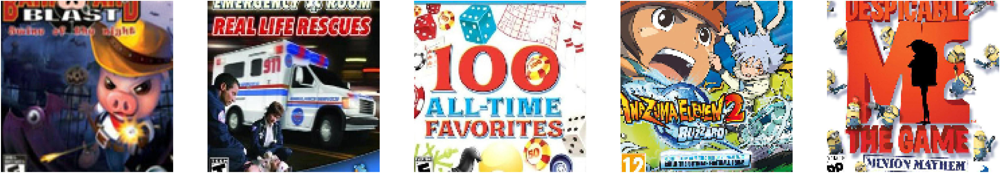

Instructions for updating:
Use keras.layers.Dense instead.
Instructions for updating:
Please use `layer.__call__` method instead.
Instructions for updating:
Use `tf.keras.layers.Conv2DTranspose` instead.
Instructions for updating:
Use keras.layers.BatchNormalization instead.  In particular, `tf.control_dependencies(tf.GraphKeys.UPDATE_OPS)` should not be used (consult the `tf.keras.layers.batch_normalization` documentation).
Instructions for updating:
Use `tf.keras.layers.Conv2D` instead.
Instructions for updating:
Use tf.where in 2.0, which has the same broadcast rule as np.where
Epoch 1/400 
Duration: 51.69273 
D Loss: 6.47635 
G Loss: 0.00009


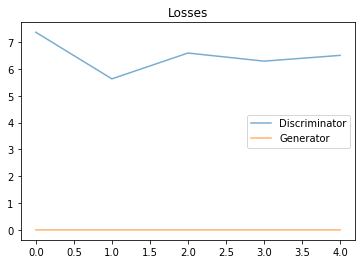

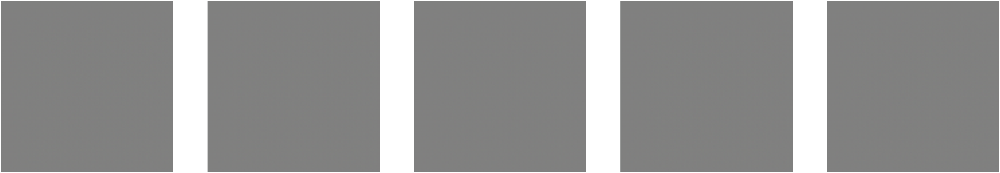

Epoch 2/400 
Duration: 35.50781 
D Loss: 6.44677 
G Loss: 0.00017


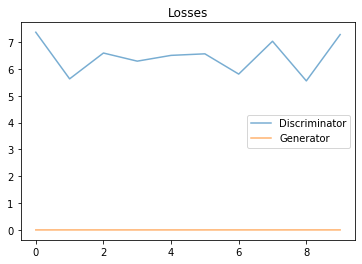

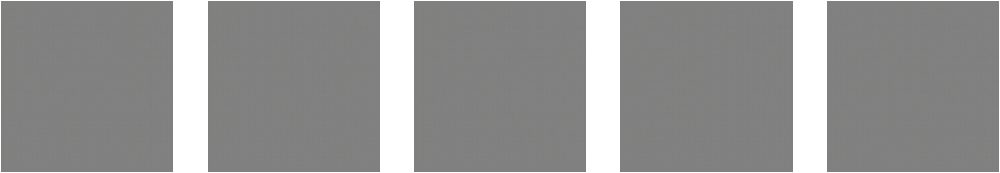

Epoch 3/400 
Duration: 35.52421 
D Loss: 5.75686 
G Loss: 0.00121


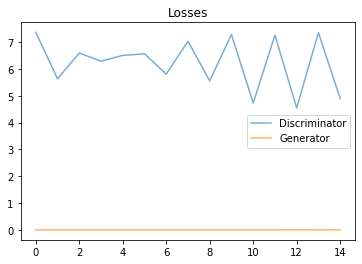

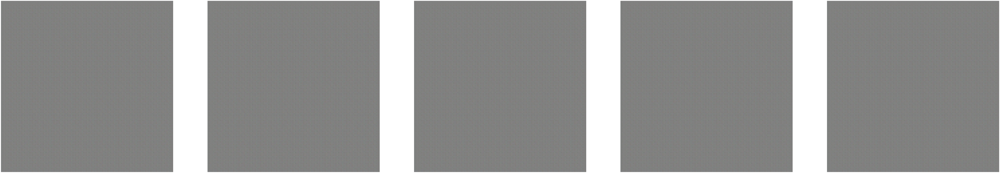

Epoch 4/400 
Duration: 35.52372 
D Loss: 6.74952 
G Loss: 0.00011


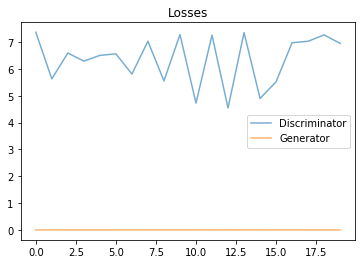

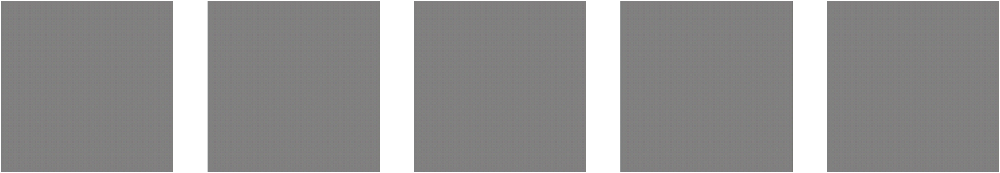

Epoch 5/400 
Duration: 35.56076 
D Loss: 6.34982 
G Loss: 0.00046


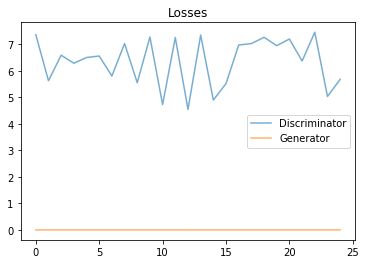

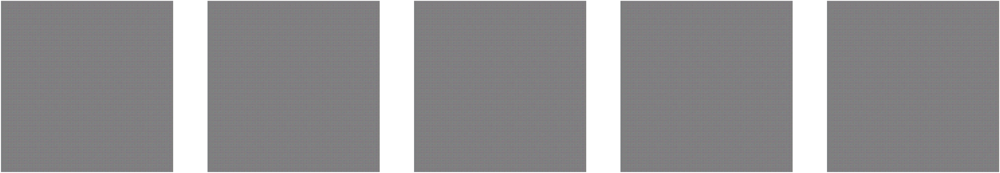

Epoch 6/400 
Duration: 35.63136 
D Loss: 5.97346 
G Loss: 0.00084


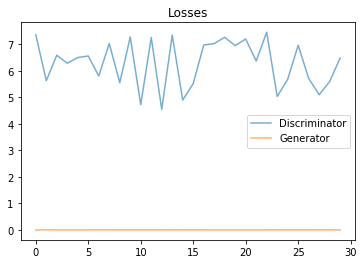

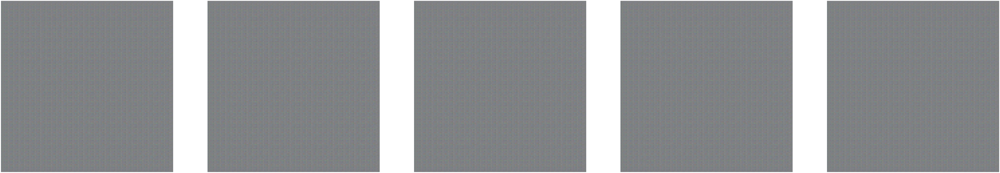

Epoch 7/400 
Duration: 35.58574 
D Loss: 7.15484 
G Loss: 0.00005


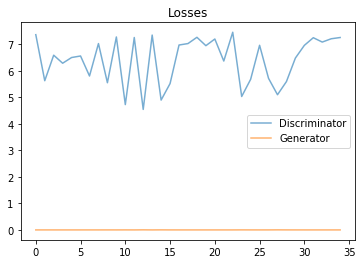

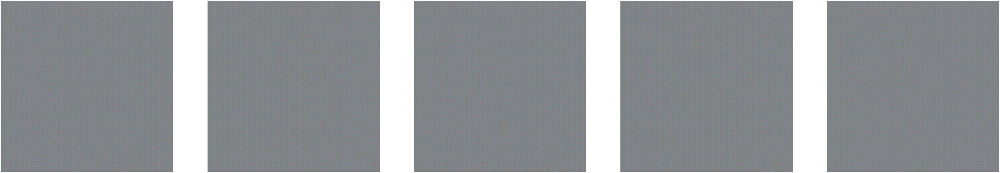

Epoch 8/400 
Duration: 35.70294 
D Loss: 7.37795 
G Loss: 0.00004


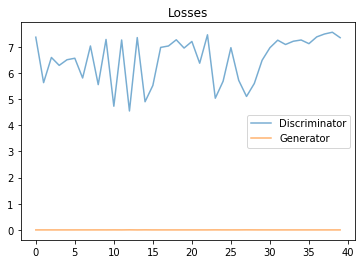

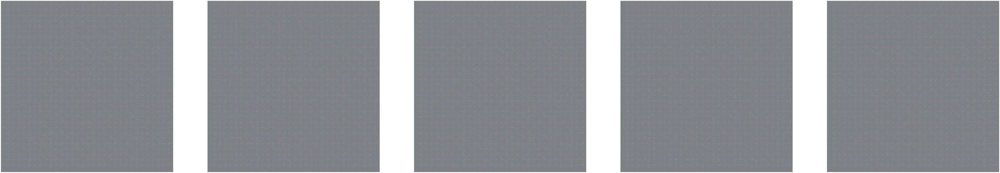

Epoch 9/400 
Duration: 35.62639 
D Loss: 5.29592 
G Loss: 0.02361


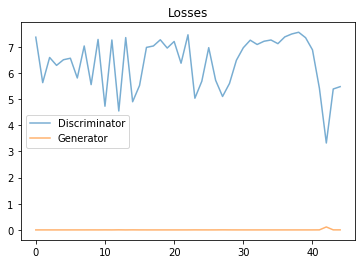

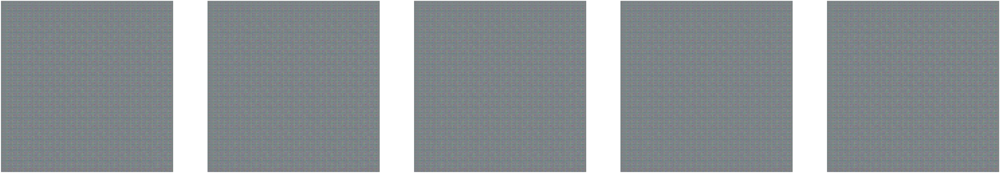

Epoch 10/400 
Duration: 35.64659 
D Loss: 7.15691 
G Loss: 0.00027


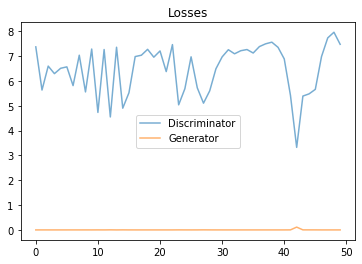

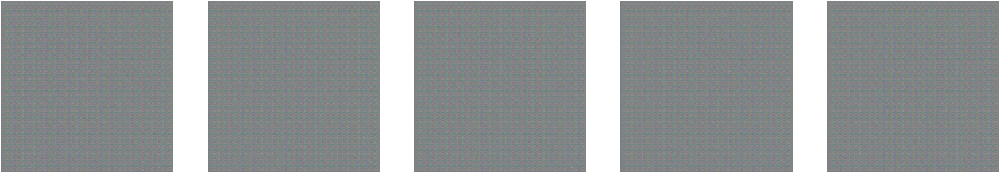

Epoch 11/400 
Duration: 35.72107 
D Loss: 5.78684 
G Loss: 0.00218


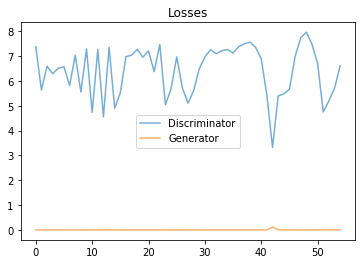

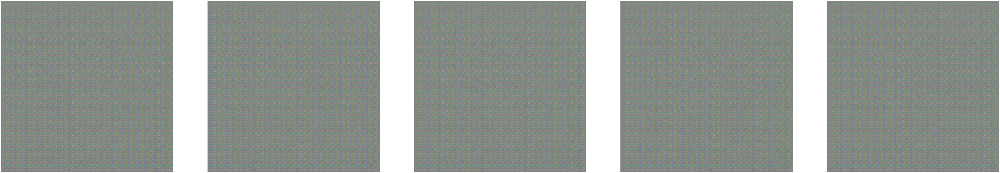

Epoch 12/400 
Duration: 35.67645 
D Loss: 7.01866 
G Loss: 0.00020


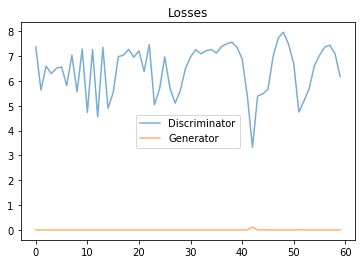

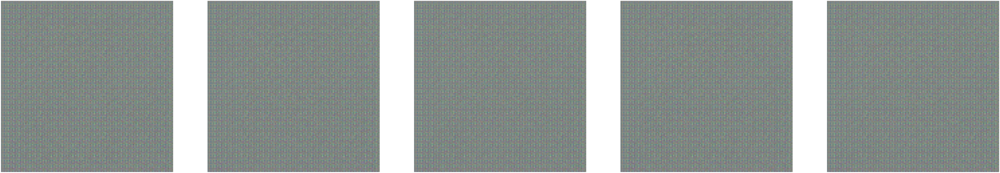

Epoch 13/400 
Duration: 35.78448 
D Loss: 6.23315 
G Loss: 0.00607


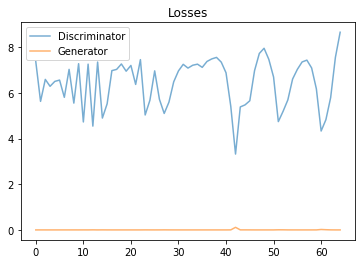

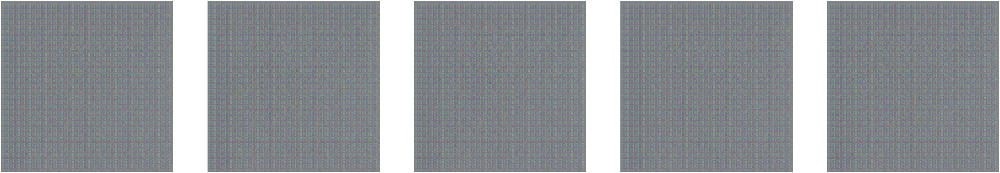

Epoch 14/400 
Duration: 35.77136 
D Loss: 6.76753 
G Loss: 0.00029


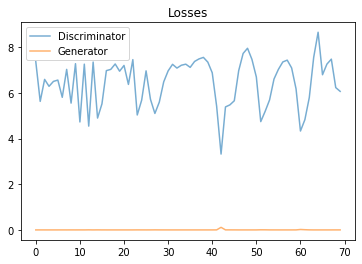

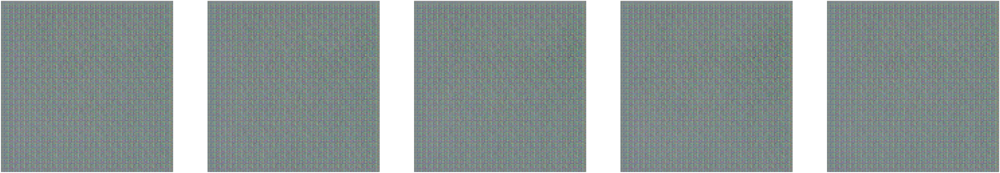

Epoch 15/400 
Duration: 35.65275 
D Loss: 5.16558 
G Loss: 0.00375


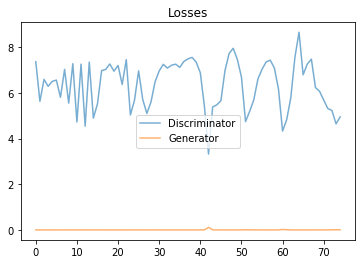

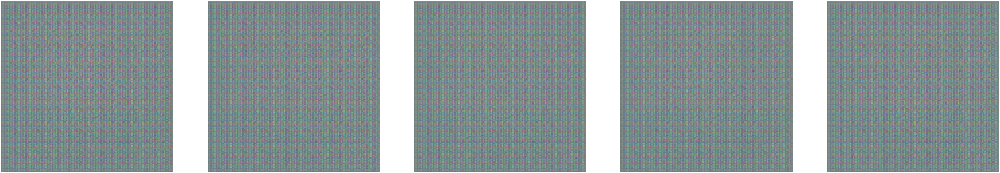

Epoch 16/400 
Duration: 35.69889 
D Loss: 4.85798 
G Loss: 0.01347


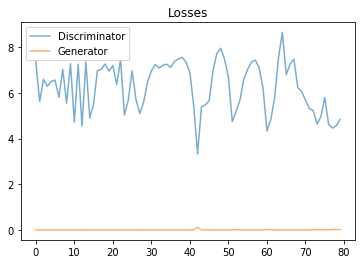

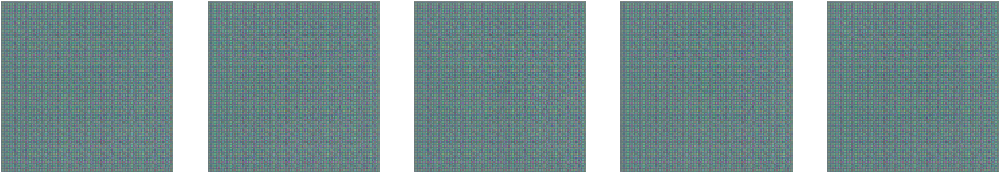

Epoch 17/400 
Duration: 35.63363 
D Loss: 4.14953 
G Loss: 0.05791


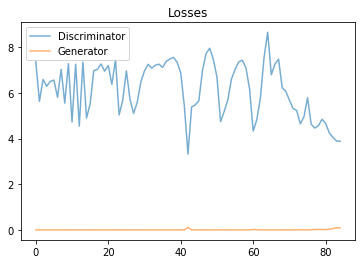

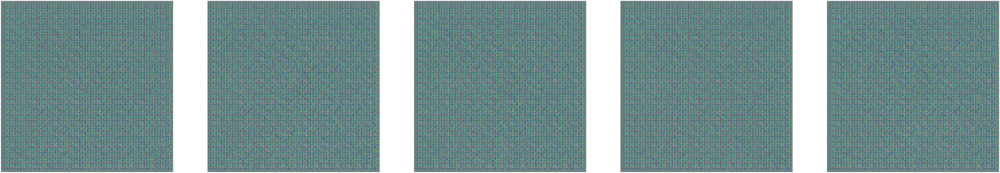

Epoch 18/400 
Duration: 35.70908 
D Loss: 4.18924 
G Loss: 0.10110


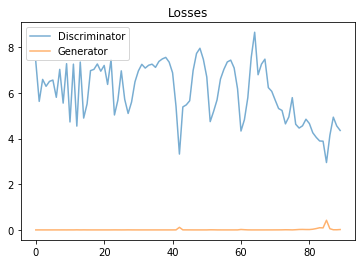

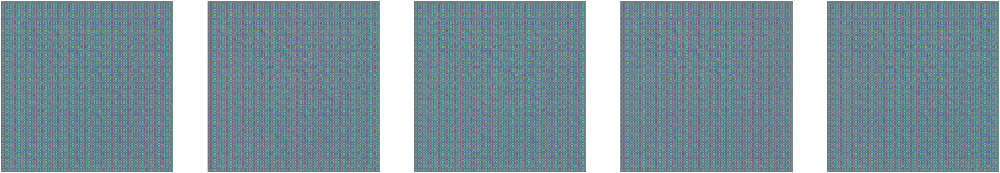

Epoch 19/400 
Duration: 35.61887 
D Loss: 3.79822 
G Loss: 0.07950


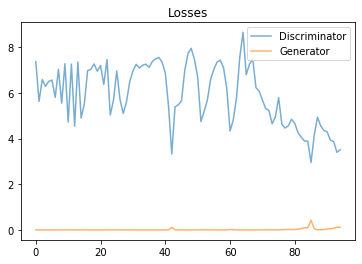

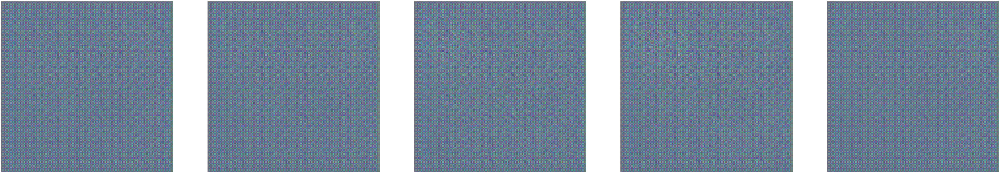

Epoch 20/400 
Duration: 35.68027 
D Loss: 3.53196 
G Loss: 0.12843


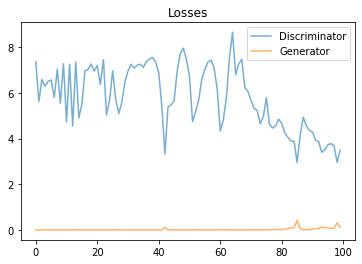

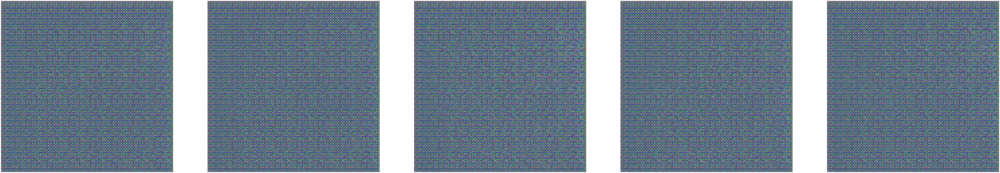

Epoch 21/400 
Duration: 35.74815 
D Loss: 3.90556 
G Loss: 0.03120


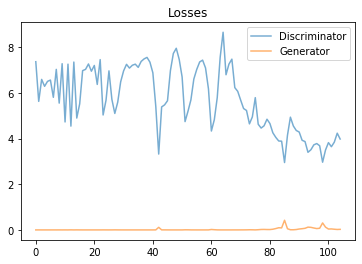

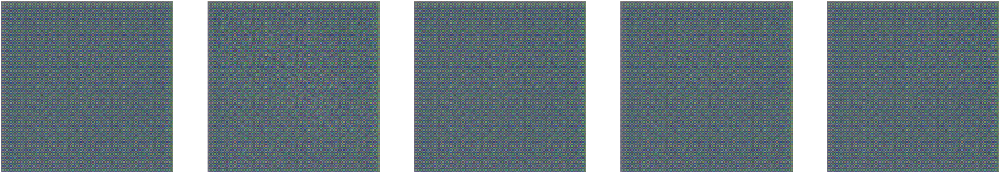

Epoch 22/400 
Duration: 35.66614 
D Loss: 3.04236 
G Loss: 0.15315


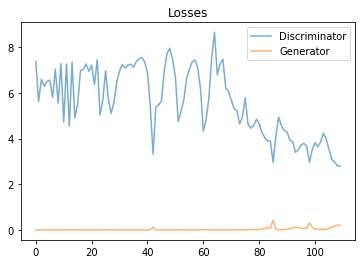

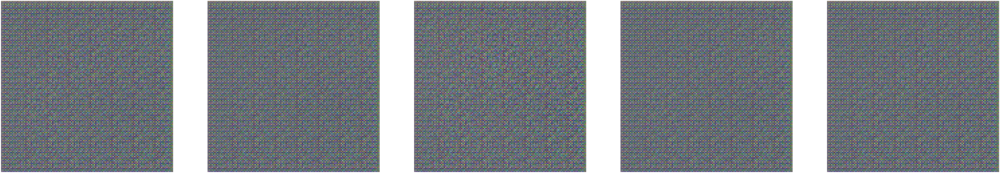

Epoch 23/400 
Duration: 35.63097 
D Loss: 2.89754 
G Loss: 0.14045


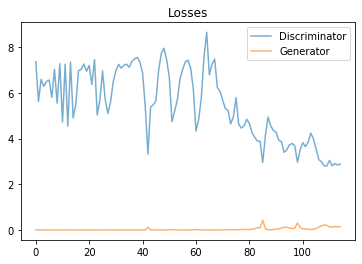

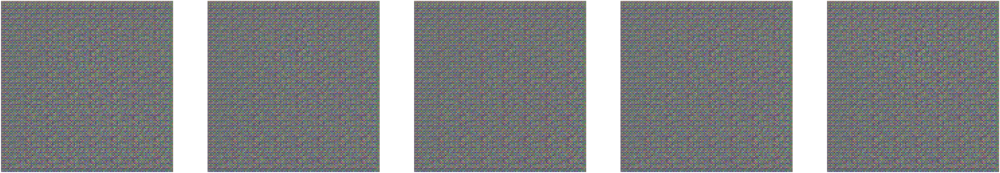

Epoch 24/400 
Duration: 35.61476 
D Loss: 2.43836 
G Loss: 0.25506


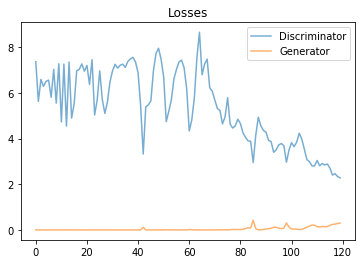

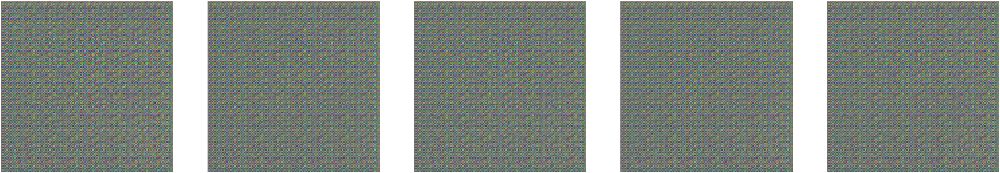

Epoch 25/400 
Duration: 35.56971 
D Loss: 2.12723 
G Loss: 0.24707


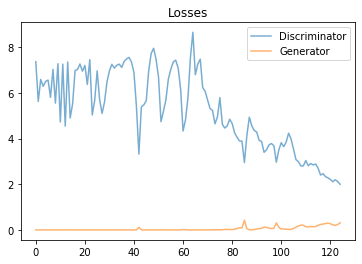

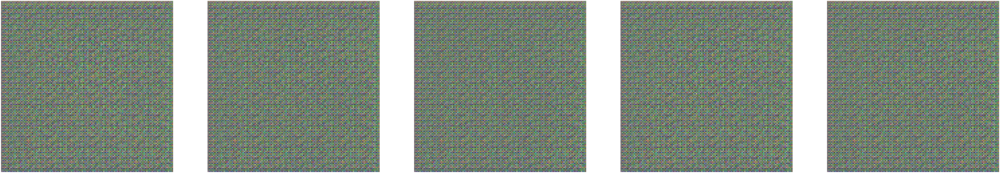

Epoch 26/400 
Duration: 35.67058 
D Loss: 1.89800 
G Loss: 0.28640


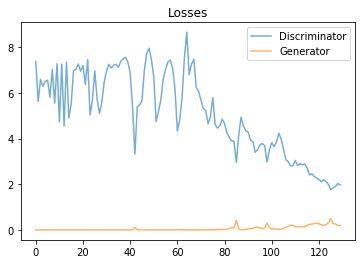

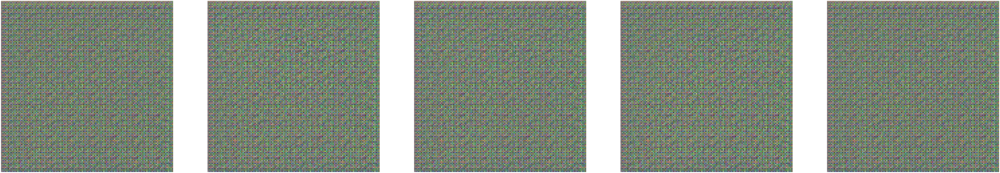

Epoch 27/400 
Duration: 35.77213 
D Loss: 1.94043 
G Loss: 0.20695


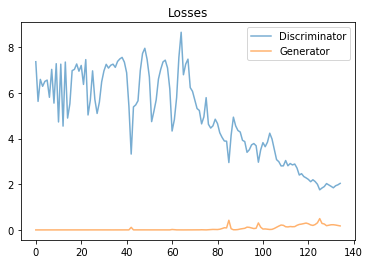

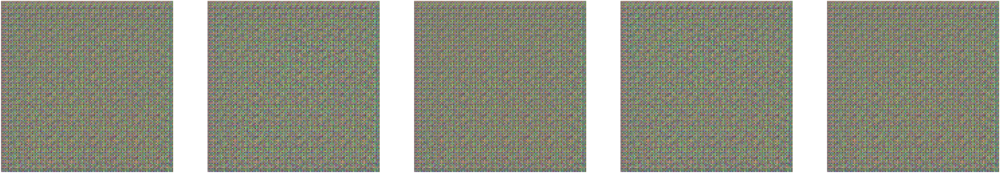

Epoch 28/400 
Duration: 35.62448 
D Loss: 1.60331 
G Loss: 0.37660


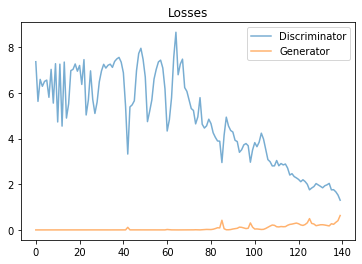

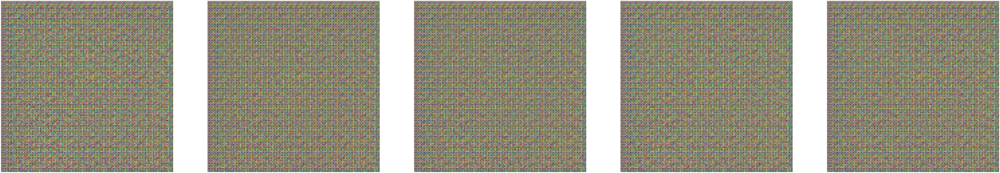

Epoch 29/400 
Duration: 35.61879 
D Loss: 1.72076 
G Loss: 0.21976


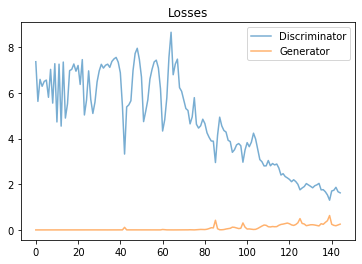

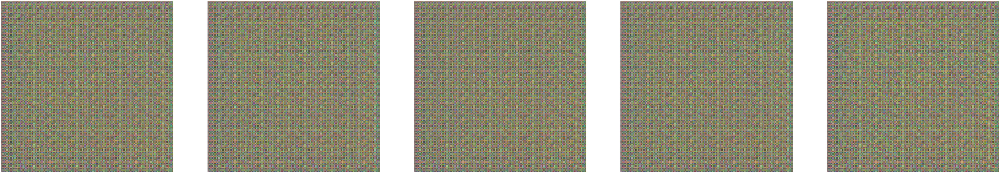

Epoch 30/400 
Duration: 35.58996 
D Loss: 1.62803 
G Loss: 0.29649


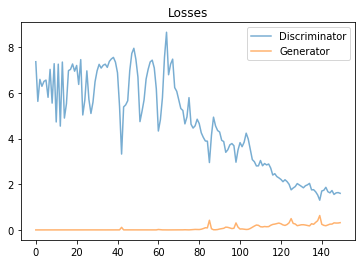

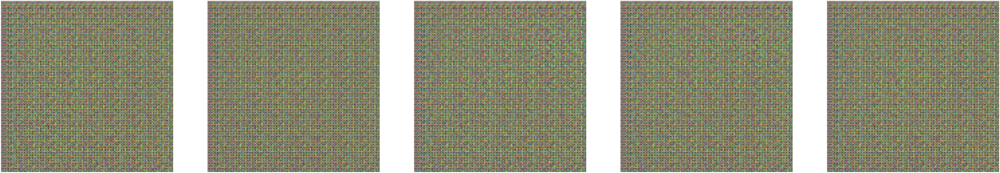

Epoch 31/400 
Duration: 35.63978 
D Loss: 1.51897 
G Loss: 0.34034


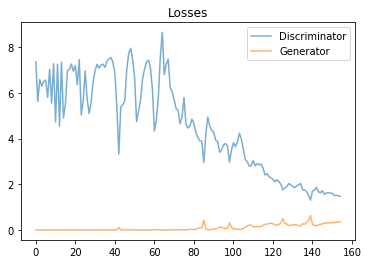

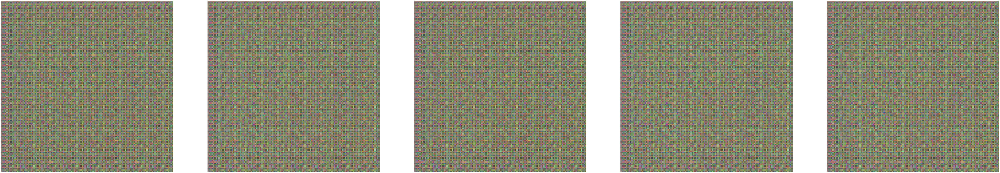

Epoch 32/400 
Duration: 35.67367 
D Loss: 1.42004 
G Loss: 0.33285


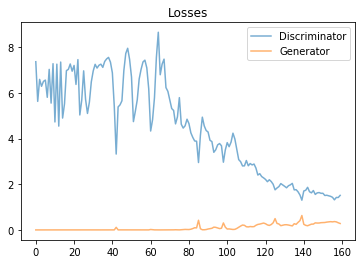

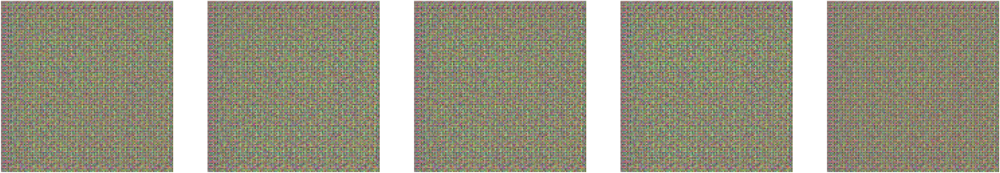

Epoch 33/400 
Duration: 35.70954 
D Loss: 1.46617 
G Loss: 0.29365


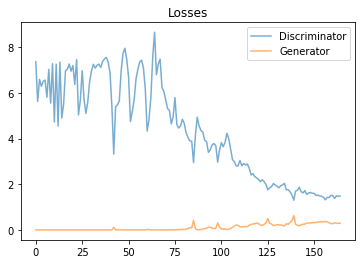

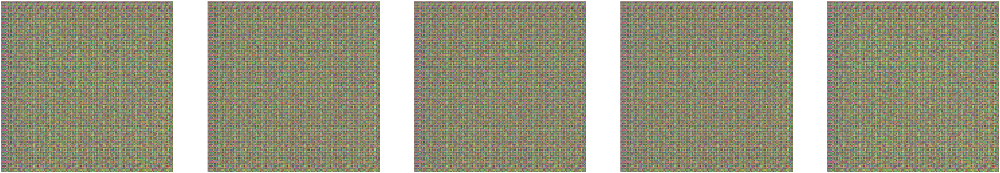

Epoch 34/400 
Duration: 35.68417 
D Loss: 1.43636 
G Loss: 0.33051


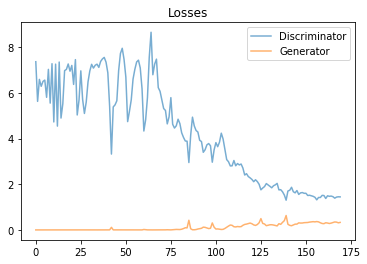

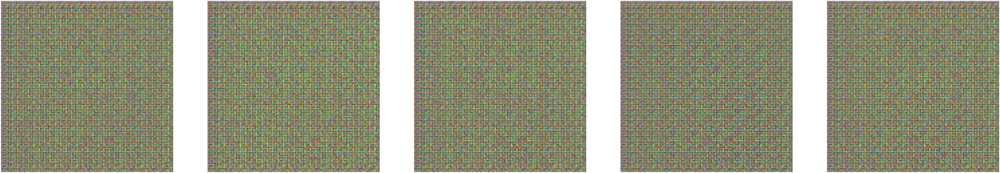

Epoch 35/400 
Duration: 35.70806 
D Loss: 1.29035 
G Loss: 0.44752


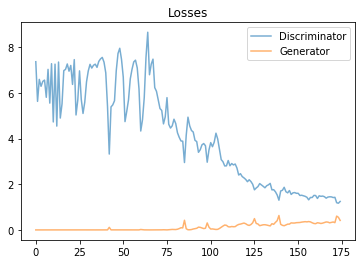

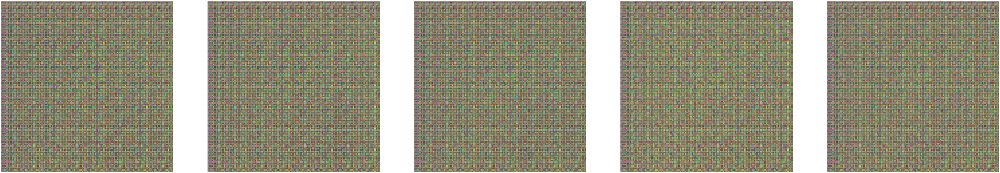

Epoch 36/400 
Duration: 35.72455 
D Loss: 1.31891 
G Loss: 0.33304


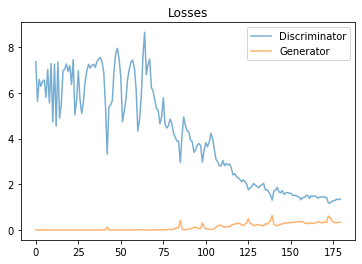

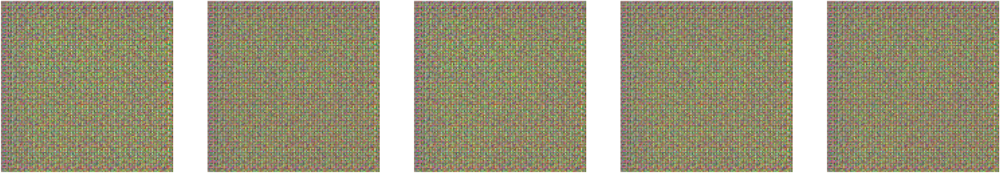

Epoch 37/400 
Duration: 35.75473 
D Loss: 1.35889 
G Loss: 0.32141


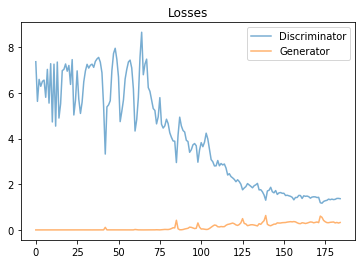

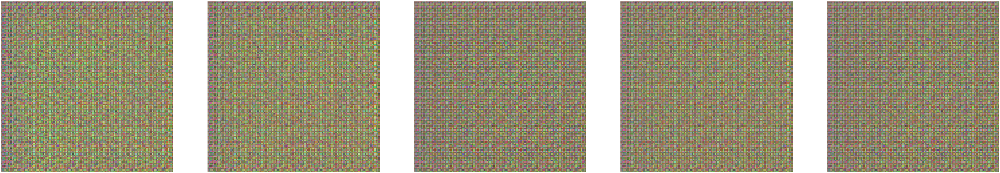

Epoch 38/400 
Duration: 35.72588 
D Loss: 1.28078 
G Loss: 0.36535


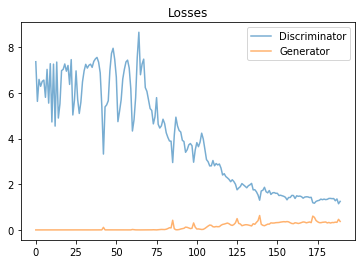

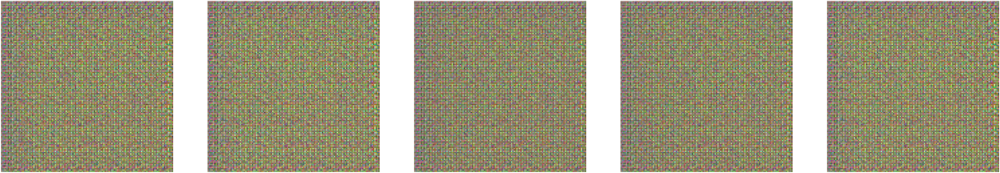

Epoch 39/400 
Duration: 35.70688 
D Loss: 1.23182 
G Loss: 0.42125


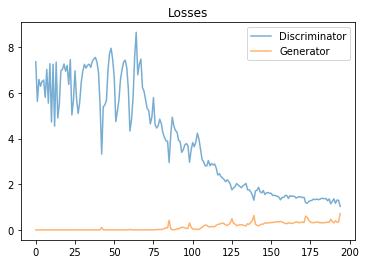

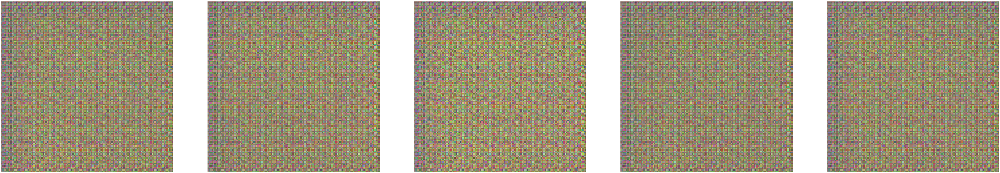

Epoch 40/400 
Duration: 35.81633 
D Loss: 1.02367 
G Loss: 0.51223


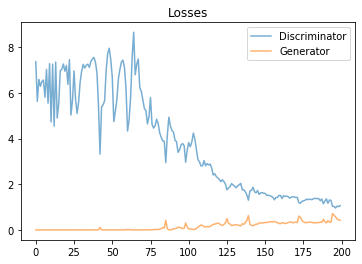

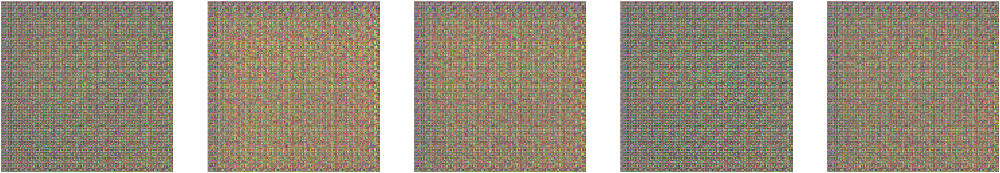

Epoch 41/400 
Duration: 35.72849 
D Loss: 1.10565 
G Loss: 0.39033


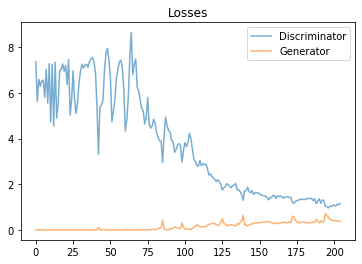

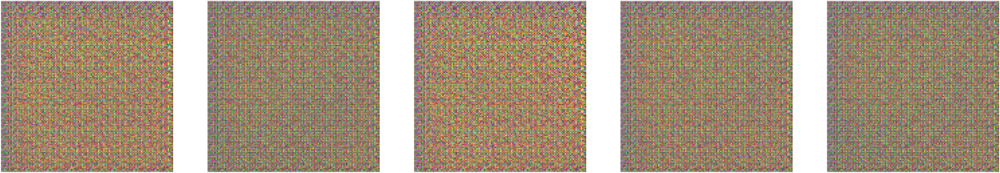

Epoch 42/400 
Duration: 35.79461 
D Loss: 1.18897 
G Loss: 0.36690


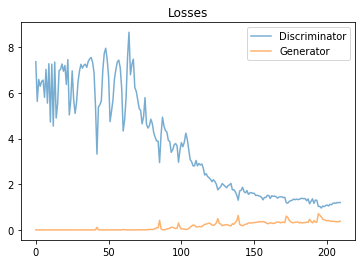

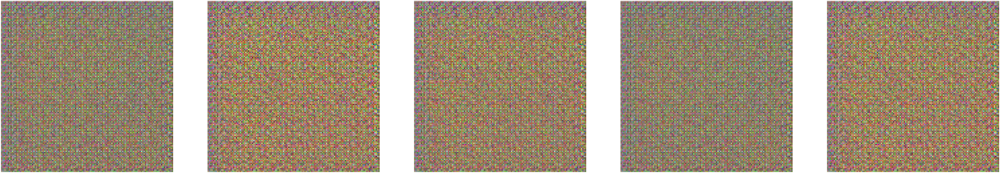

Epoch 43/400 
Duration: 35.78345 
D Loss: 1.21765 
G Loss: 0.36157


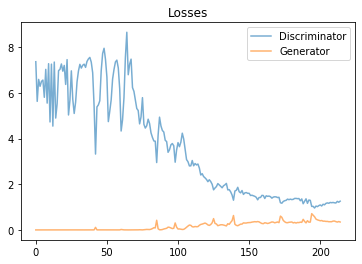

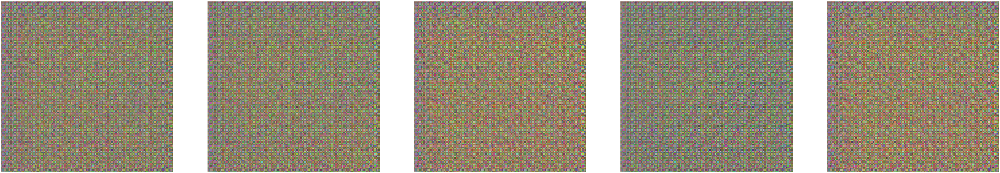

Epoch 44/400 
Duration: 35.82874 
D Loss: 1.26899 
G Loss: 0.32499


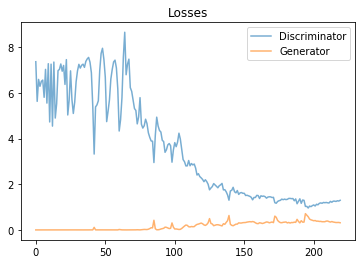

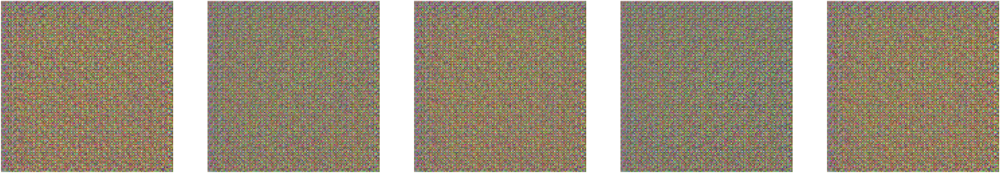

Epoch 45/400 
Duration: 35.73384 
D Loss: 1.23074 
G Loss: 0.37268


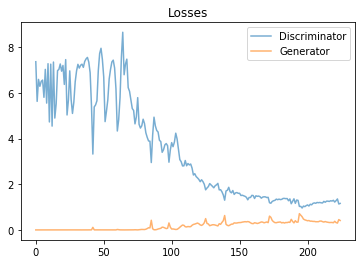

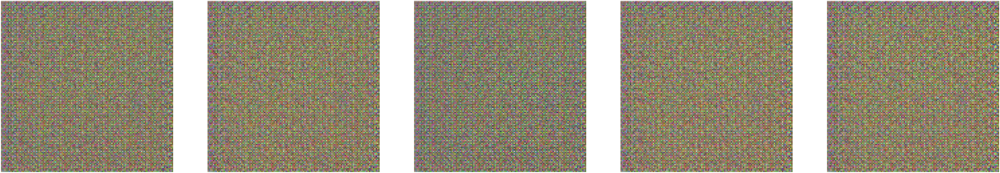

Epoch 46/400 
Duration: 35.64570 
D Loss: 1.23130 
G Loss: 0.34911


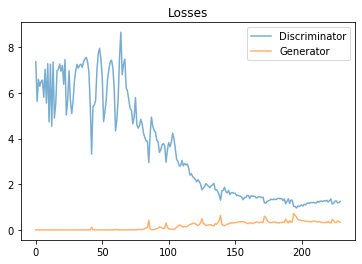

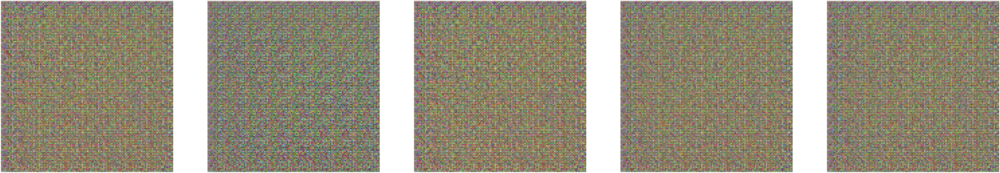

Epoch 47/400 
Duration: 35.62574 
D Loss: 1.22366 
G Loss: 0.36181


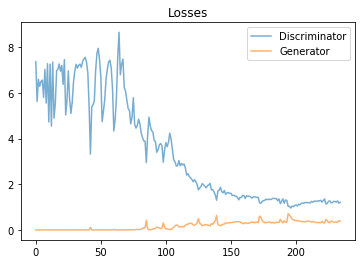

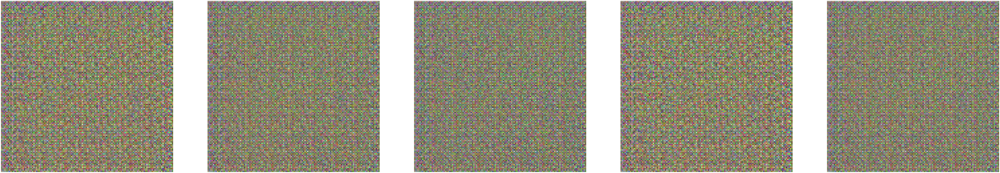

Epoch 48/400 
Duration: 35.77689 
D Loss: 1.07385 
G Loss: 0.47528


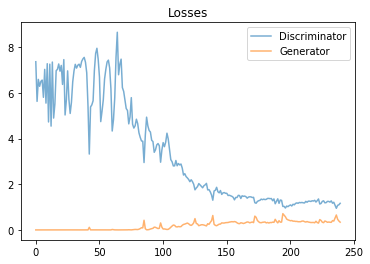

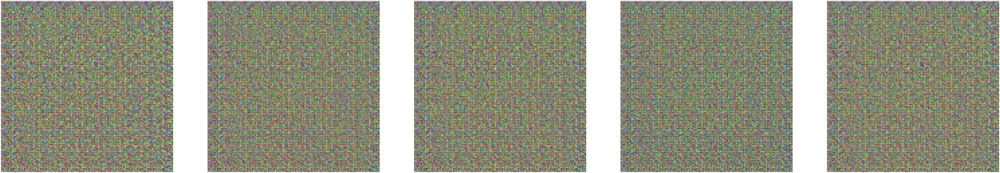

Epoch 49/400 
Duration: 35.74530 
D Loss: 1.24288 
G Loss: 0.31274


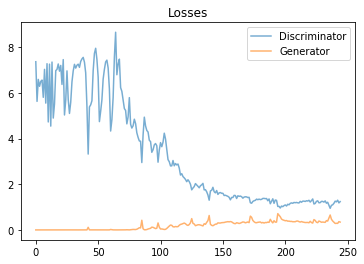

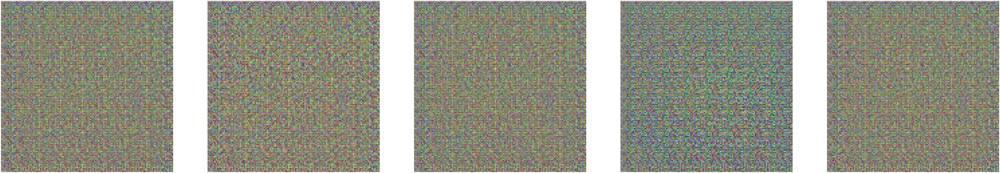

Epoch 50/400 
Duration: 35.73733 
D Loss: 1.06853 
G Loss: 0.47595


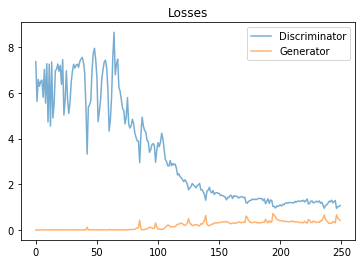

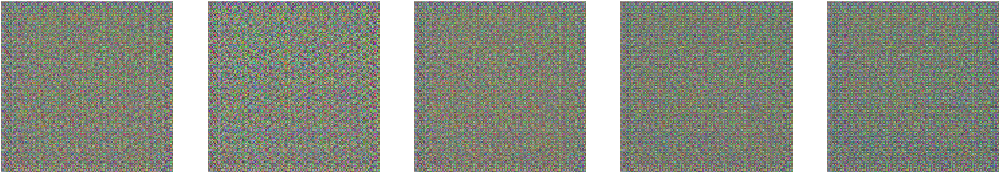

Epoch 51/400 
Duration: 35.66944 
D Loss: 1.20060 
G Loss: 0.33083


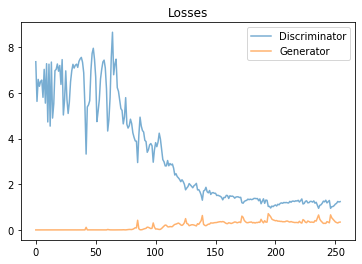

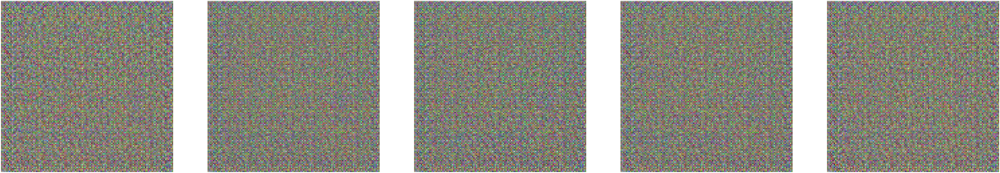

Epoch 52/400 
Duration: 35.61725 
D Loss: 0.95569 
G Loss: 0.62959


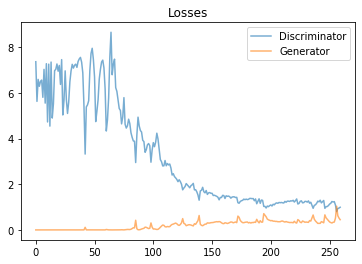

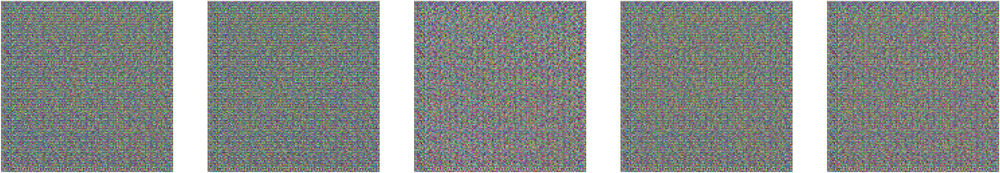

Epoch 53/400 
Duration: 35.66612 
D Loss: 1.07686 
G Loss: 0.38442


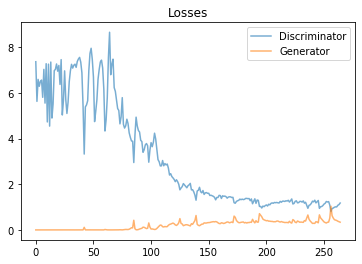

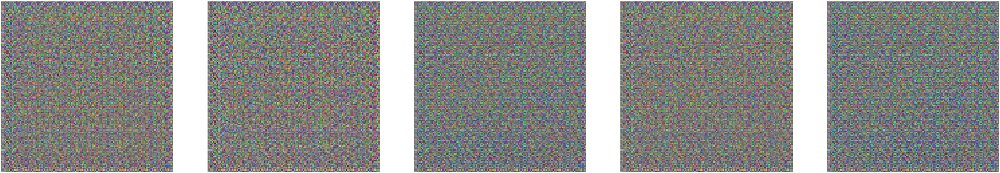

Epoch 54/400 
Duration: 35.78316 
D Loss: 1.24490 
G Loss: 0.33601


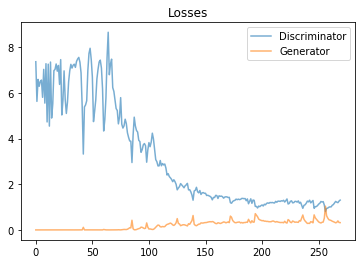

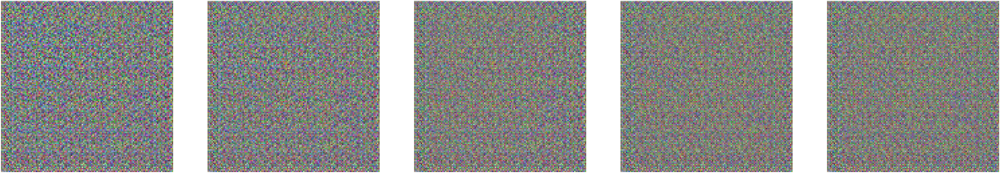

Epoch 55/400 
Duration: 35.78057 
D Loss: 1.04019 
G Loss: 0.52593


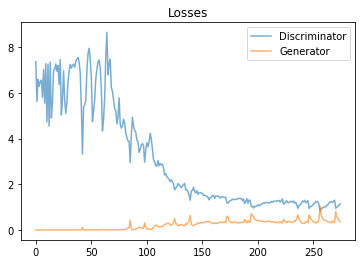

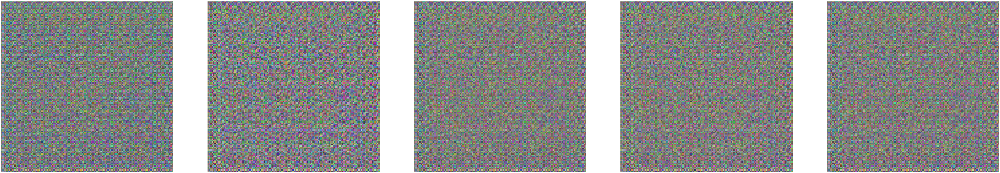

Epoch 56/400 
Duration: 35.76638 
D Loss: 1.13621 
G Loss: 0.44033


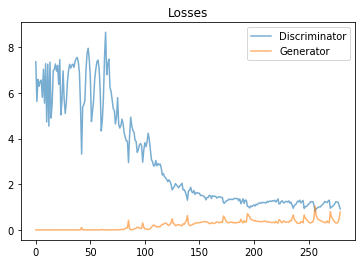

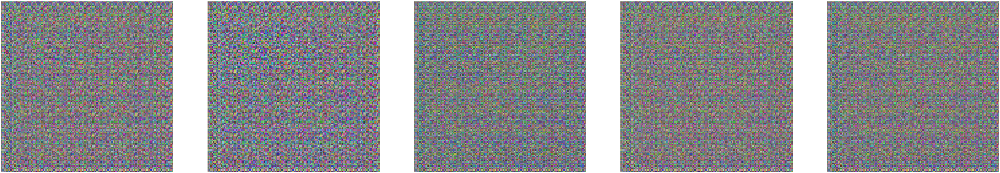

Epoch 57/400 
Duration: 35.73477 
D Loss: 1.10515 
G Loss: 0.40388


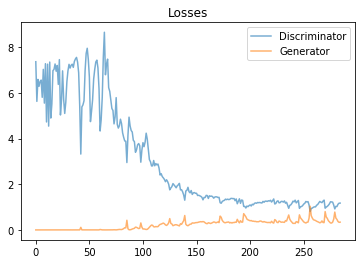

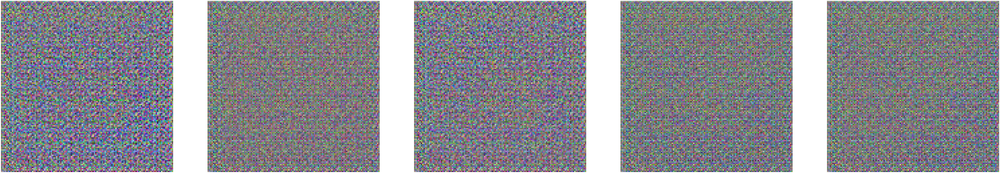

Epoch 58/400 
Duration: 35.73747 
D Loss: 1.14114 
G Loss: 0.41529


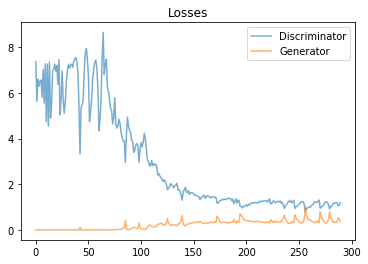

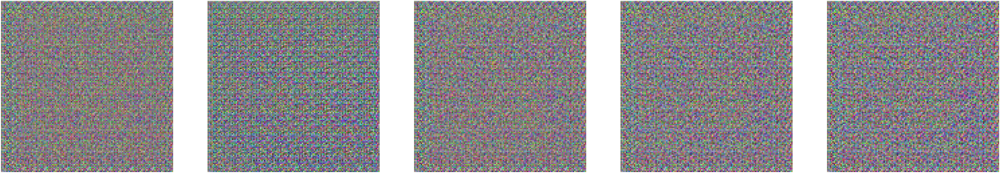

Epoch 59/400 
Duration: 35.64461 
D Loss: 0.91829 
G Loss: 0.71930


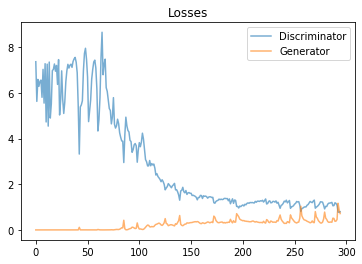

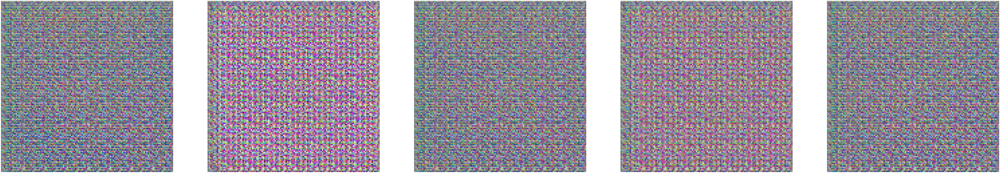

Epoch 60/400 
Duration: 35.67291 
D Loss: 0.81419 
G Loss: 0.60062


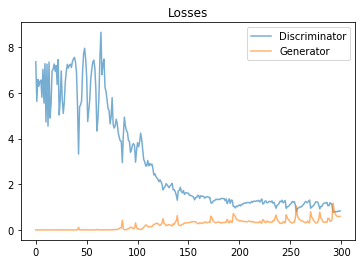

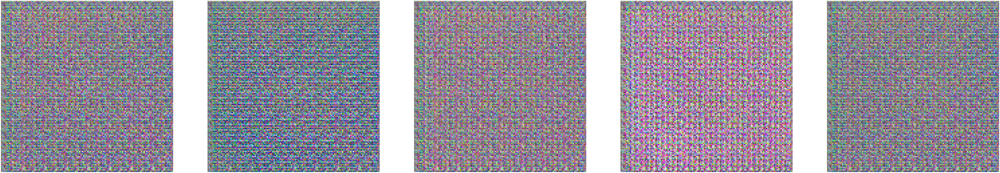

Epoch 61/400 
Duration: 35.66387 
D Loss: 0.85872 
G Loss: 0.56713


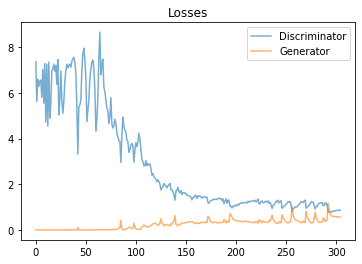

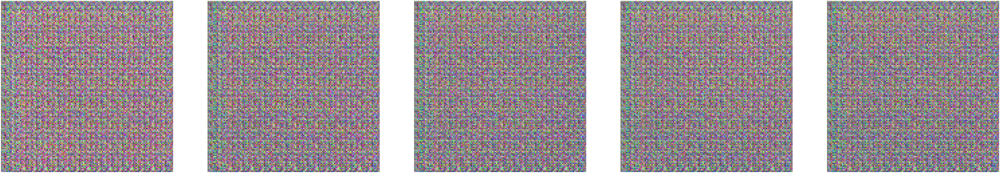

Epoch 62/400 
Duration: 35.64385 
D Loss: 0.86477 
G Loss: 0.56493


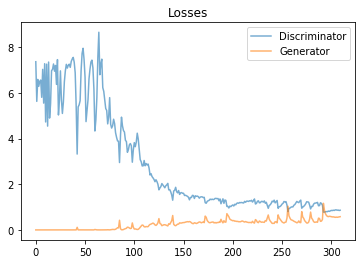

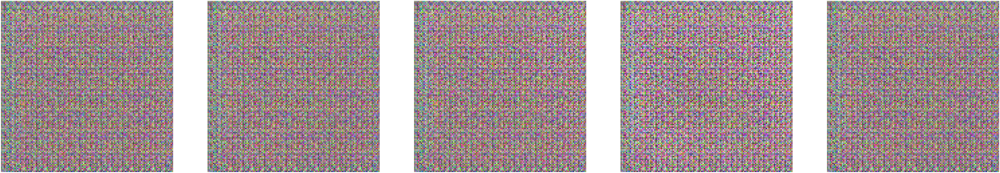

Epoch 63/400 
Duration: 35.60307 
D Loss: 0.86086 
G Loss: 0.56955


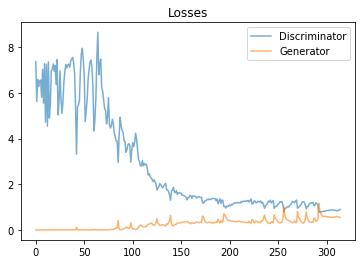

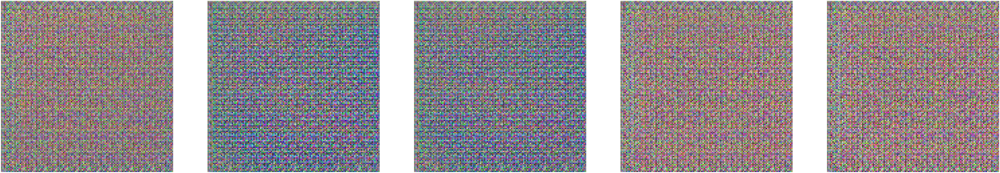

Epoch 64/400 
Duration: 35.59007 
D Loss: 0.92107 
G Loss: 0.49811


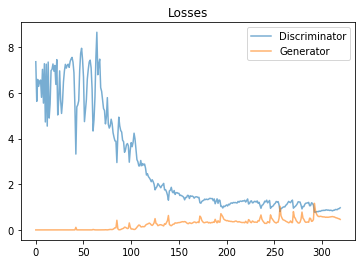

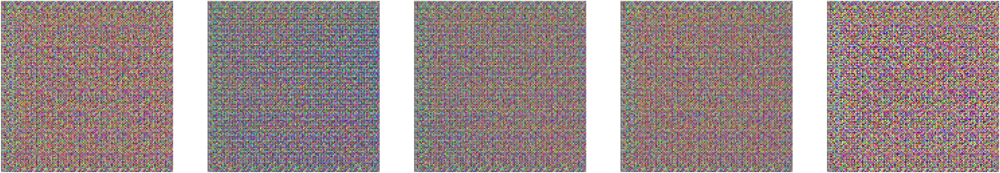

Epoch 65/400 
Duration: 35.63467 
D Loss: 0.99664 
G Loss: 0.42872


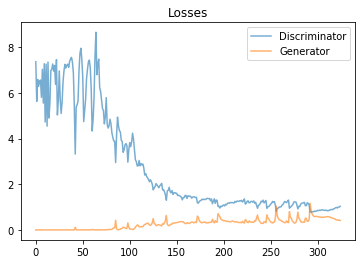

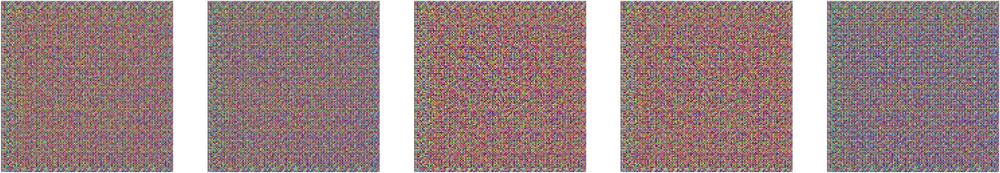

Epoch 66/400 
Duration: 35.69022 
D Loss: 1.06848 
G Loss: 0.42697


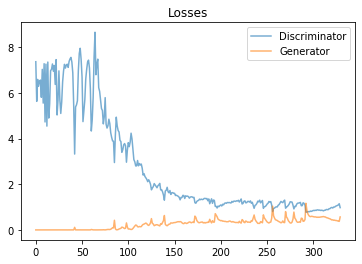

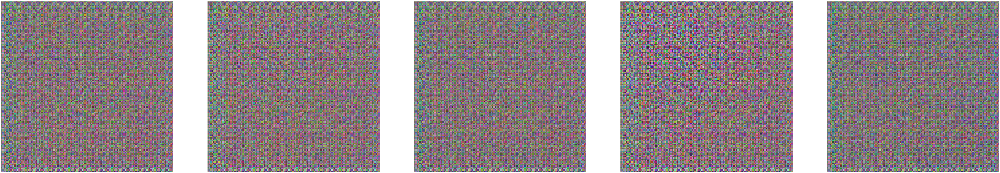

Epoch 67/400 
Duration: 35.70603 
D Loss: 1.02658 
G Loss: 0.45387


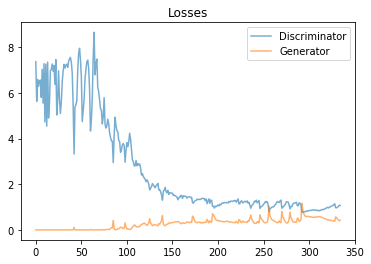

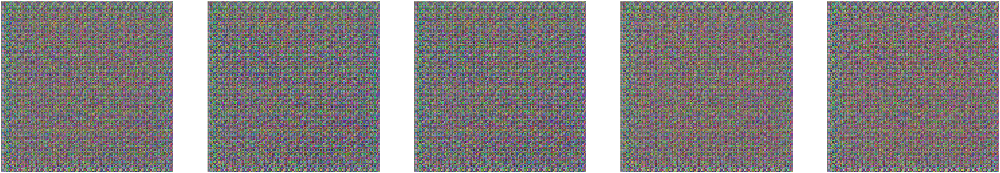

Epoch 68/400 
Duration: 35.90251 
D Loss: 1.11004 
G Loss: 0.39086


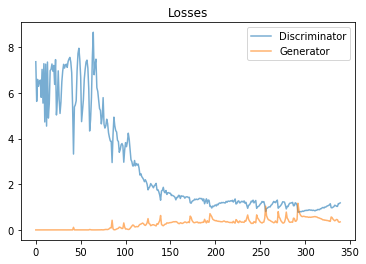

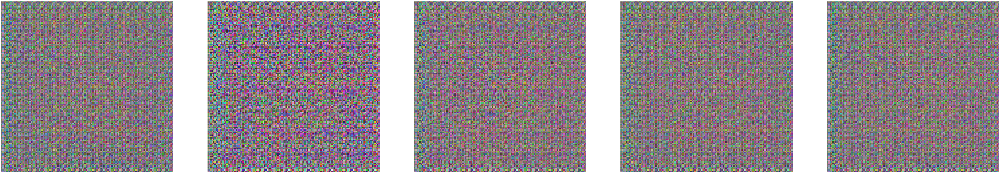

Epoch 69/400 
Duration: 35.63354 
D Loss: 1.01341 
G Loss: 0.52100


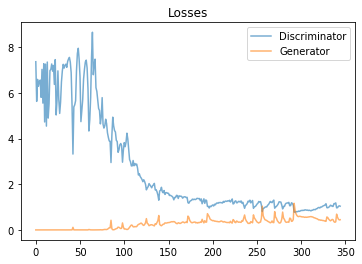

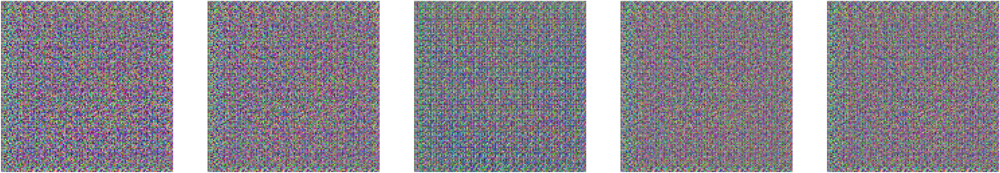

Epoch 70/400 
Duration: 35.70839 
D Loss: 1.05881 
G Loss: 0.45855


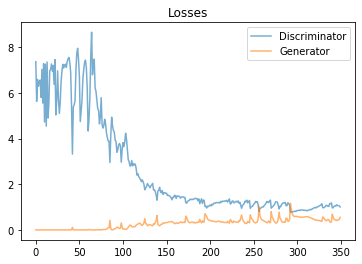

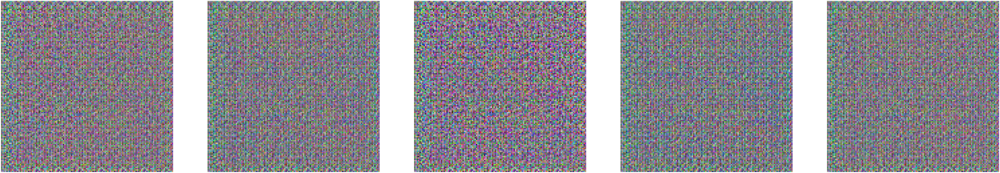

Epoch 71/400 
Duration: 35.72215 
D Loss: 0.98809 
G Loss: 0.50334


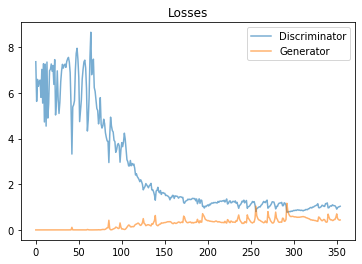

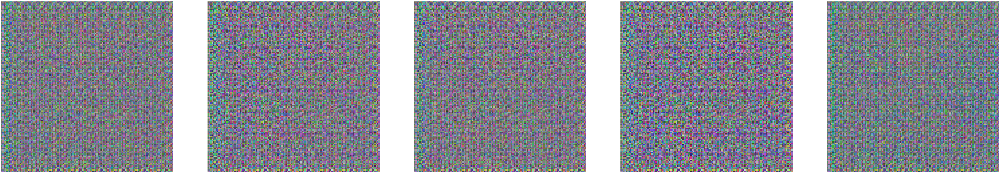

Epoch 72/400 
Duration: 35.74565 
D Loss: 1.05320 
G Loss: 0.44919


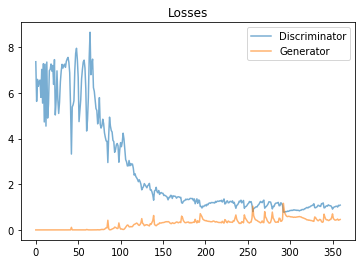

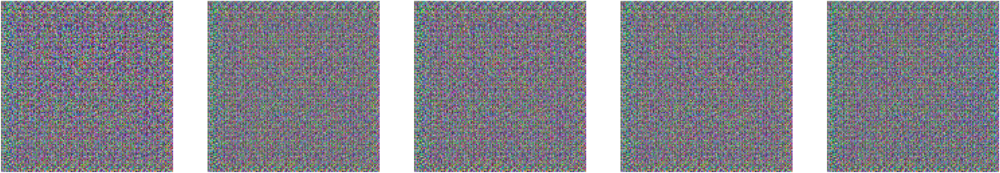

Epoch 73/400 
Duration: 35.74156 
D Loss: 0.97658 
G Loss: 0.52380


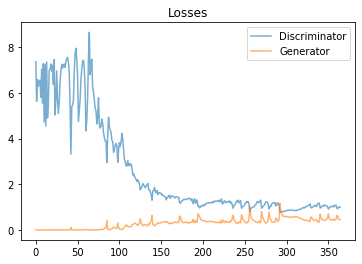

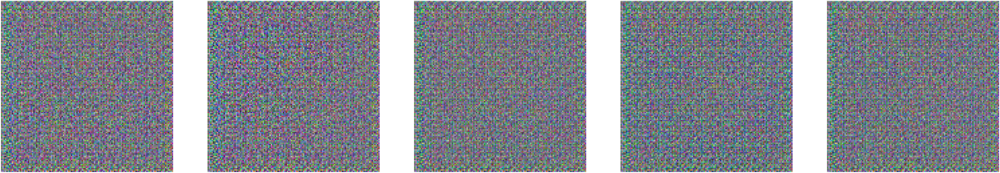

Epoch 74/400 
Duration: 35.64678 
D Loss: 1.01102 
G Loss: 0.46817


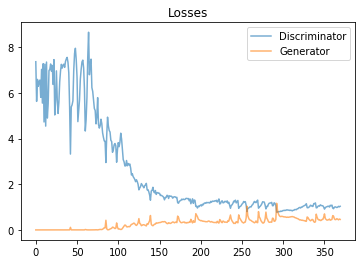

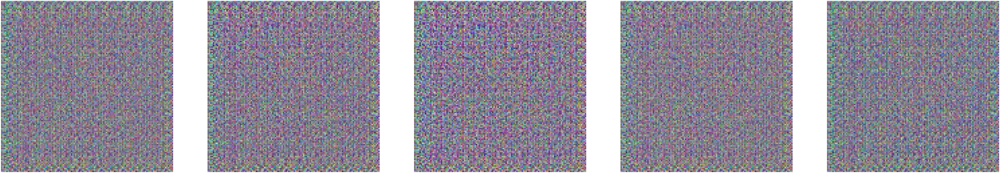

Epoch 75/400 
Duration: 35.54514 
D Loss: 1.01972 
G Loss: 0.46090


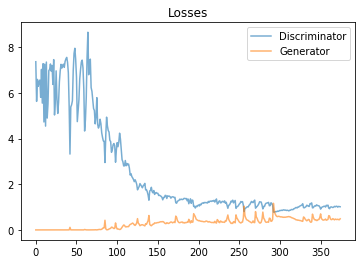

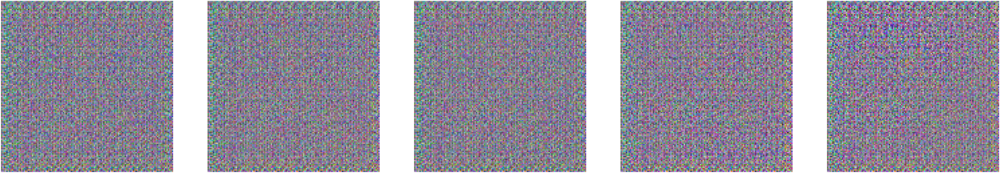

Epoch 76/400 
Duration: 35.71111 
D Loss: 0.97023 
G Loss: 0.50565


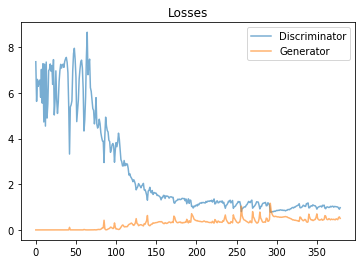

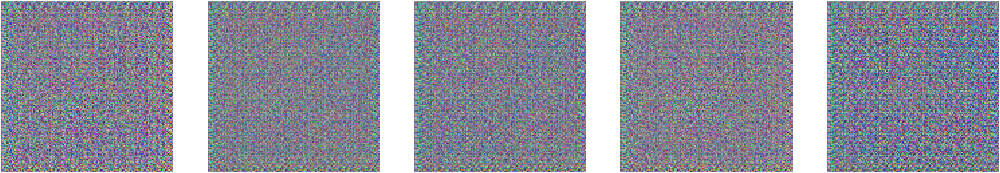

Epoch 77/400 
Duration: 35.59693 
D Loss: 0.97119 
G Loss: 0.49475


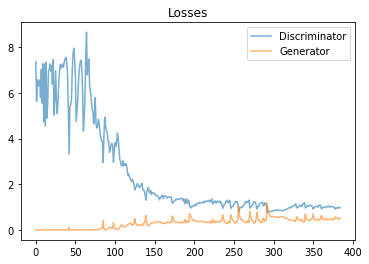

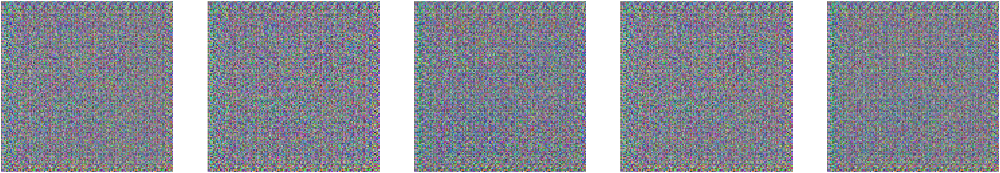

Epoch 78/400 
Duration: 35.70379 
D Loss: 0.94894 
G Loss: 0.52642


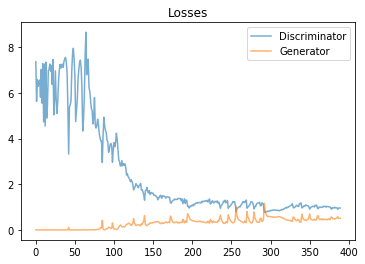

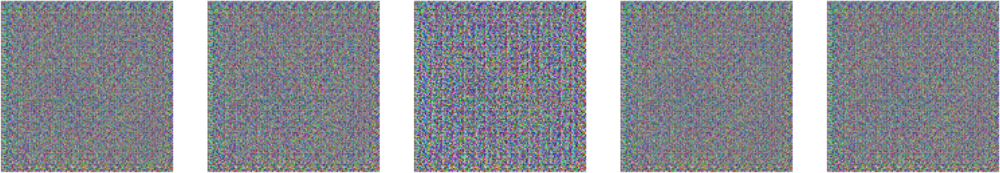

Epoch 79/400 
Duration: 35.90420 
D Loss: 0.96593 
G Loss: 0.48929


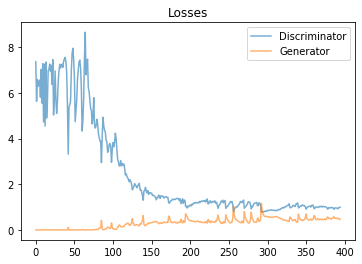

Buffered data was truncated after reaching the output size limit.

In [31]:
# Training
input_images = np.asarray([np.asarray(Image.open(file).resize((IMAGE_SIZE, IMAGE_SIZE))) for file in glob(INPUT_DATA_DIR + '*')])
print ("Input: " + str(input_images.shape))

np.random.shuffle(input_images)

sample_images = random.sample(list(input_images), SAMPLES_TO_SHOW)
show_samples(sample_images, OUTPUT_DIR + "inputs", 0)

with tf.Graph().as_default():
    train(get_batches(input_images), input_images.shape)

In [0]:
!cd sample_data/

In [33]:
!ls sample_data/


anscombe.json		      mnist_test.csv
california_housing_test.csv   mnist_train_small.csv
california_housing_train.csv  README.md
